In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from subprocess import check_output
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
data = pd.read_csv('train.csv',encoding='utf-8').dropna().drop('id',axis=1) #There is a nan in here?
data['cos_sim'] = None

In [4]:
data.head()

,qid1,qid2,question1,question2,is_duplicate,cos_sim
0,1,2,What is the step by step guide to invest in sh...,What is the step by step guide to invest in sh...,0,None
1,3,4,What is the story of Kohinoor (Koh-i-Noor) Dia...,What would happen if the Indian government sto...,0,None
2,5,6,How can I increase the speed of my internet co...,How can Internet speed be increased by hacking...,0,None
3,7,8,Why am I mentally very lonely? How can I solve...,Find the remainder when [math]23^{24}[/math] i...,0,None
4,9,10,"Which one dissolve in water quikly sugar, salt...",Which fish would survive in salt water?,0,None


In [5]:
corpus =pd.concat([data.question1,data.question2])
cv = CountVectorizer().fit(corpus)

In [6]:
import pandas as pd
from multiprocessing import Pool


def q_cosine_similarity(df):
    df['cos_sim'] = df.apply(lambda x: float(cosine_similarity(cv.transform([x.question1]),cv.transform([x.question2]))[0][0]),axis=1)
    return df

def parallelize_dataframe(df, func):
    df_split = np.array_split(df, 10)
    pool = Pool(4)
    df = pd.concat(pool.map(func, df_split))
    pool.close()
    pool.join()
    return df

data = parallelize_dataframe(data, q_cosine_similarity)

In [17]:
print np.mean(data.loc[data.is_duplicate==1,'cos_sim'])
print np.mean(data.loc[data.is_duplicate!=1,'cos_sim'])

0.624751623936
0.43451252141


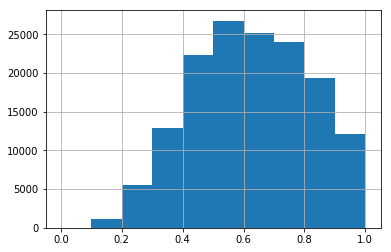

In [25]:
#data['cos_sim'].hist()
data.loc[data.is_duplicate==1,'cos_sim'].hist()
#data.loc[data.is_duplicate!=1,'cos_sim'].hist()

In [24]:
data.loc[data.is_duplicate==1,:]

,qid1,qid2,question1,question2,is_duplicate,cos_sim
5,11,12,Astrology: I am a Capricorn Sun Cap moon and c...,"I'm a triple Capricorn (Sun, Moon and ascendan...",1,0.606339
7,15,16,How can I be a good geologist?,What should I do to be a great geologist?,1,0.338062
11,23,24,How do I read and find my YouTube comments?,How can I see all my Youtube comments?,1,0.534522
12,25,26,What can make Physics easy to learn?,How can you make physics easy to learn?,1,0.801784
13,27,28,What was your first sexual experience like?,What was your first sexual experience?,1,0.925820
15,31,32,What would a Trump presidency mean for current...,How will a Trump presidency affect the student...,1,0.179284
16,33,34,What does manipulation mean?,What does manipulation means?,1,0.750000
18,37,38,Why are so many Quora users posting questions ...,Why do people ask Quora questions which can be...,1,0.346688
20,41,42,Why do rockets look white?,Why are rockets and boosters painted white?,1,0.507093
29,59,60,How should I prepare for CA final law?,How one should know that he/she completely pre...,1,0.628971


In [56]:
data.sample(frac=.00001)

,qid1,qid2,question1,question2,is_duplicate,cos_sim,q1_len,q2_len,diff
78291,133521,133522,What should I do if I want to be prettier?,How can I meet the expectations of a client as...,0,0.000000,42,63,21
177650,273038,273039,How many consecutive days does 1 million secon...,Is 1.998 approximately equal to 1.997?,0,0.144338,55,38,17
133619,213723,213724,Where are all the conservatives on Quora?,Are there any conservatives on Quora?,1,0.617213,41,37,4
343015,188852,232494,How many medals should we expect from India th...,This time India sent Nation's largest delegati...,1,0.460566,65,113,48


In [40]:
data['q1_len'] = data['question1'].apply(lambda x: len(x))
data['q2_len'] = data['question2'].apply(lambda x: len(x))
data['diff'] = abs(data['q1_len'] - data['q2_len'])

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x116b50ad0>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x116c7c390>]], dtype=object)

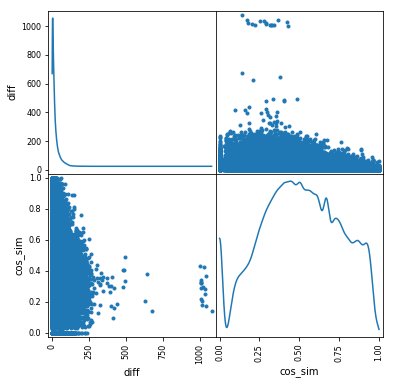

In [45]:
from pandas.tools.plotting import scatter_matrix
scatter_matrix(data[['diff','cos_sim']], alpha=1, figsize=(6, 6), diagonal='kde')

In [50]:
from bokeh.charts import Scatter, output_file, show, output_notebook

scatter = Scatter(data, x='diff', y='cos_sim', color='is_duplicate',
                  title="quora", xlabel="difference in length",
                  ylabel="cosine similarity")

Loading BokehJS ...

In [54]:
scatter2 = Scatter(data, x='q1_len', y='q2_len', color='is_duplicate',
                  title="quora", xlabel="question1 length",
                  ylabel="question2 length")
show(scatter2)

In [62]:
train = data.loc[:,['cos_sim','q1_len','q2_len','diff']]
target = data.loc[:,'is_duplicate']

In [63]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100, n_jobs=2)
rf.fit(train, target)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_split=1e-07, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=100, n_jobs=2, oob_score=False, random_state=None,
            verbose=0, warm_start=False)

In [105]:
import pandas as pd
from multiprocessing import Pool
import re
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.tokenize import word_tokenize
stemmer = PorterStemmer()
lemmatiser = WordNetLemmatizer()

def q_cosine_similarity(df):
    df['cos_sim'] = df.apply(lambda x: float(cosine_similarity(cv2.transform([x.question1]),cv2.transform([x.question2]))[0][0]),axis=1)
    return df

def parallelize_dataframe(df, func):
    df_split = np.array_split(df, 10)
    pool = Pool(4)
    df = pd.concat(pool.map(func, df_split))
    pool.close()
    pool.join()
    return df

def tokenize(text):
    texts=word_tokenize(text)
    # This tokenizes the tweet into a list of words 
    # Let's now return this list minus any stopwords 
    return [lemmatiser.lemmatize(word) for word in texts if len(word)>2]

def preProcess(text):
    text = re.sub("[^a-zA-Z]", " ", text) 
    # 1. Convert to lower case
    text=text.lower()
    # You can do further cleanup as well if you like, replace 
    # repetitions of characters, for ex: change "huuuuungry" to "hungry"
    # We'll leave that as an exercise for you on regular expressions
    return text

test = pd.read_csv('test.csv',encoding='utf-8')
test['cos_sim'] = None
corpus2 =pd.concat([test.question1,test.question2])
cv2 = CountVectorizer(encoding='utf-8',decode_error='ignore',strip_accents='ascii',
                             analyzer='word',preprocessor = preProcess,tokenizer=tokenize).fit(corpus2.values.astype('U'))
test = parallelize_dataframe(test, q_cosine_similarity)
test.head()

TypeError: ('expected string or buffer', u'occurred at index 817520')

In [99]:
corpus2.values()

TypeError: 'numpy.ndarray' object is not callable

In [ ]:
test['q1_len'] = test['question1'].apply(lambda x: len(x))
test['q2_len'] = test['question2'].apply(lambda x: len(x))
test['diff'] = abs(test['q1_len'] - test['q2_len'])

In [75]:
test.head()

,test_id,question1,question2,cos_sim
0,0,How does the Surface Pro himself 4 compare wit...,Why did Microsoft choose core m3 and not core ...,None
1,1,Should I have a hair transplant at age 24? How...,How much cost does hair transplant require?,None
2,2,What but is the best way to send money from Ch...,What you send money to China?,None
3,3,Which food not emulsifiers?,What foods fibre?,None
4,4,"How ""aberystwyth"" start reading?",How their can I start reading?,None


In [ ]:
#from sklearn.metrics import log_loss
#print log_loss()
#pred = rf.predict()
#quora_output = pd.DataFrame({"test_id":test_id, "is_duplicate":preds})
#quora_output.to_csv("submission.csv", index=False)
